In [ ]:
# !pip install transformers
# !pip install scikit-learn
# !pip install accelerate
# !pip uninstall bitsandbytes
# !pip install -i https://test.pypi.org/simple/ bitsandbytes
# !pip install matplotlib

In [1]:
import os
import gc
import time
import random
import torch
import numpy as np
from PIL import Image
from transformers import ViTImageProcessor, ViTModel
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from tqdm import tqdm
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
processor = ViTImageProcessor.from_pretrained('facebook/dino-vitb16')
model = ViTModel.from_pretrained('facebook/dino-vitb16')

Some weights of ViTModel were not initialized from the model checkpoint at facebook/dino-vitb16 and are newly initialized: ['pooler.dense.bias', 'pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [9]:
import requests
url = "http://images.cocodataset.org/val2017/000000039769.jpg"
image = Image.open(requests.get(url, stream=True).raw)

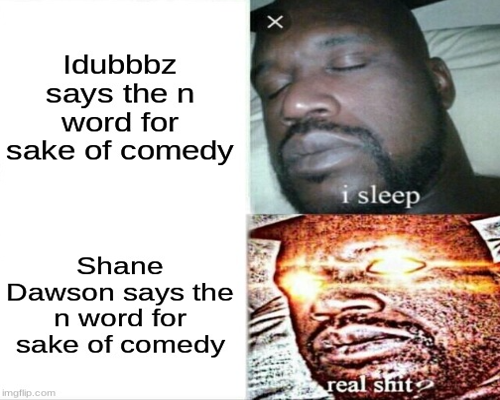

In [4]:
raw_image = Image.open(img_dir).convert("RGB")
display(raw_image.resize((500, 400)))

In [11]:
inputs = processor(images=image, return_tensors="pt")
outputs = model(**inputs)
last_hidden_states = outputs.last_hidden_state

In [13]:
last_hidden_states.shape

torch.Size([1, 197, 768])

In [17]:
# img_dir = "./data/memes"
# img_features = []
# for file in tqdm(os.listdir(img_dir)):
#     if file.endswith(".jpg") or file.endswith(".png"):
#         file_path = os.path.join(img_dir, file)
#         img = Image.open(file_path)
#         inputs = processor(images=img, return_tensors="pt").to(device, torch.float16)
#         img_outputs = model.get_image_features(**inputs)
#         img_tensor = img_outputs.last_hidden_state
#         img_features.append(img_tensor)
#         del inputs, img_outputs, img_tensor


root_dir = "./data/"
dirs = ["CoronavirusMemes", "dank_meme", "dankmeme", \
        "funny", "memes"]
all_images = []
for _dir in dirs:
    files = os.listdir(root_dir+_dir)
    jpg_files = [file for file in files if file.endswith(".jpg")]
    random_images = random.sample(jpg_files, 100)
    for image in random_images:
        image = root_dir+_dir+'/'+image
        all_images.append(image)

# print(all_images)
img_features = []
batch_size = 1
for i in tqdm(range(0, len(all_images), batch_size)):
    try:
        batch_files = all_images[i:i+batch_size]
        batch_images = []
        for file in batch_files:
            if file.endswith(".jpg"):
                file_path = file
                img = Image.open(file_path)
                batch_images.append(img)
        batch_inputs = processor(batch_images, return_tensors="pt")
        batch_outputs = model(**batch_inputs)
        batch_tensor = batch_outputs.last_hidden_state
        img_features.append(batch_tensor)
        gc.collect()
        del batch_inputs, batch_outputs
        torch.cuda.empty_cache()
    except:
        pass

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 354/500 [02:47<01:13,  1.97it/s]/nas/home/syjoshi/miniconda3/envs/imkg/lib/python3.8/site-packages/PIL/Image.py:3176: DecompressionBombWarning: Image size (108000000 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(
100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 500/500 [04:05<00:00,  2.04it/s]


In [18]:
features = torch.cat(img_features, dim=0)

In [19]:
num_samples = len(img_features)
features = features.reshape(num_samples, -1)
features_np = features.detach().cpu().numpy()

In [20]:
pca = PCA(n_components=2)
features_pca = pca.fit_transform(features_np)

  0%|                                                                                                                                                           | 0/9 [00:00<?, ?it/s]/nas/home/syjoshi/miniconda3/envs/imkg/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|████████████████▎                                                                                                                                  | 1/9 [00:04<00:35,  4.42s/it]/nas/home/syjoshi/miniconda3/envs/imkg/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/nas/home/syjoshi/miniconda3/envs/imkg/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: Th

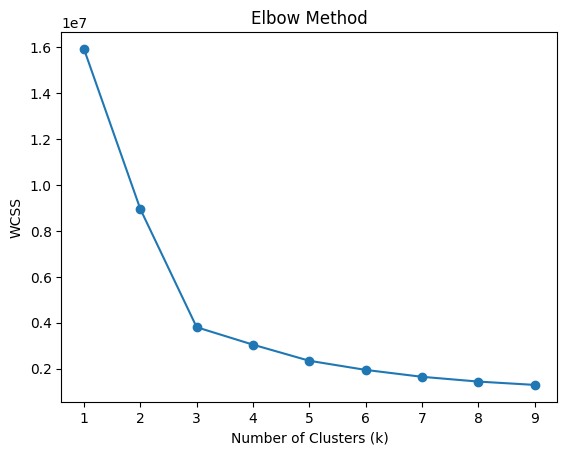

In [21]:
wcss = []
k_vals = range(1,10)
for k in tqdm(k_vals):
    kmeans = KMeans(n_clusters=k, random_state=0)
    kmeans.fit(features_pca)
    wcss.append(kmeans.inertia_)
    
plt.plot(k_vals, wcss, marker='o')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('WCSS')
plt.title('Elbow Method')
plt.show()

In [22]:
k = 3
kmeans = KMeans(n_clusters=k, random_state=0)
kmeans.fit(features_pca)

/nas/home/syjoshi/miniconda3/envs/imkg/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


KMeans(n_clusters=3, random_state=0)

In [23]:
cluster_labels = kmeans.labels_
cluster_centers = kmeans.cluster_centers_

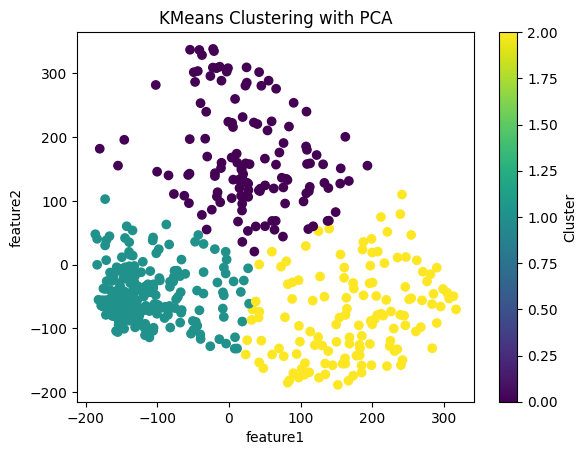

In [24]:
plt.scatter(features_pca[:, 0], features_pca[:, 1], c=cluster_labels, cmap='viridis')
plt.xlabel('feature1')
plt.ylabel('feature2')
plt.title('KMeans Clustering with PCA')
plt.colorbar(label='Cluster')
plt.show()

In [45]:
cluster0 = {}
cluster1 = {}
cluster2 = {}
c0 = []
c1 = []
c2 = []
for x, y in zip(all_images, cluster_labels):
    if y == 0:
        c0.append(x)
    elif y == 1:
        c1.append(x)
    elif y == 2:
        c2.append(x)

def img_cluster(cluster, c):
    for x in c:
        y = x.split('/')[-2]
        if y not in cluster:
            cluster[y] = 0
        cluster[y] += 1
    return cluster

def bar_plot(cluster, num):
    keys = list(cluster.keys())
    values = list(cluster.values())
    plt.bar(keys, values)
    plt.xlabel('Subreddit')
    plt.ylabel('Values')
    plt.title('Cluster '+str(num))
    plt.show()
    
def subplots(img_list):
    c = 3
    r = len(img_list) // c
    r += (len(img_list) % c > 0)
    fig, axes = plt.subplots(r, c, figsize=(10, 100))
    axes = axes.flatten()
    for i, img_name in enumerate(img_list):
        img = plt.imread(img_name)
        axes[i].imshow(img)
        axes[i].axis('off')
        #axes[i].set_title(image_name)
    for j in range(len(img_list), len(axes)):
        axes[j].axis('off')
    plt.tight_layout()
    plt.show()

cluster0 = img_cluster(cluster0, c0)
cluster1 = img_cluster(cluster1, c1)
cluster2 = img_cluster(cluster2, c2)

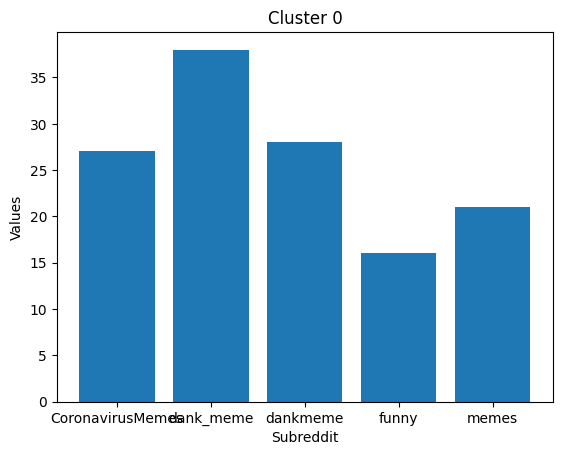

In [46]:
bar_plot(cluster0, 0)

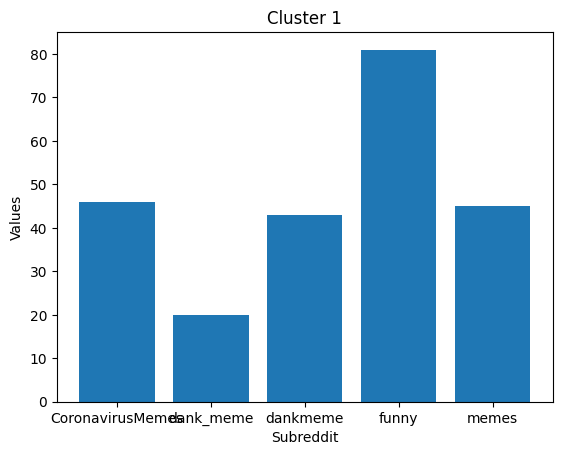

In [47]:
bar_plot(cluster1, 1)

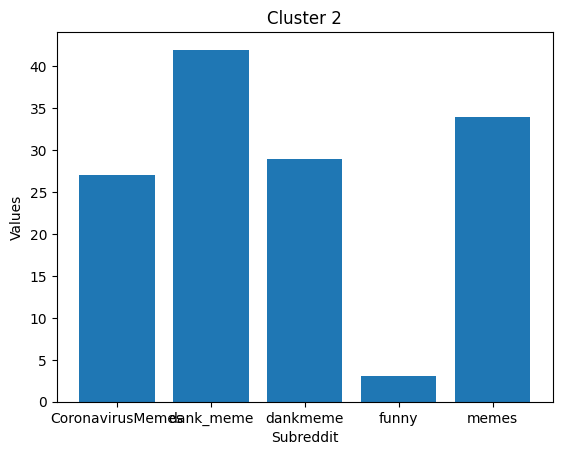

In [48]:
bar_plot(cluster2, 2)

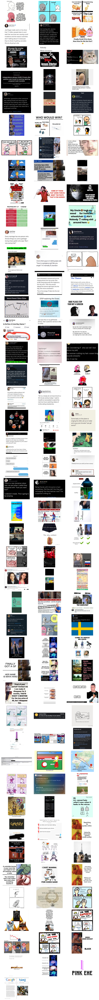

In [49]:
subplots(c0)

/nas/home/syjoshi/miniconda3/envs/imkg/lib/python3.8/site-packages/PIL/Image.py:3176: DecompressionBombWarning: Image size (108000000 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


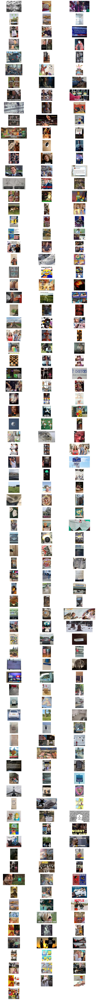

In [50]:
subplots(c1)

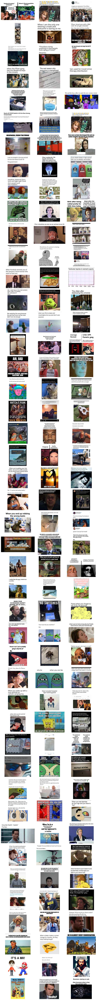

In [51]:
subplots(c2)